# Ejemplo de análisis espacial: densidad de la red vial

[![Abrir en Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/gf0657-programacionsig/2024-ii/blob/main/contenido/4/ejemplo-analisis-densidad-red-vial.ipynb)

## Introducción

La densidad de la red vial para un polígono se define como:

$$
\text{densidad de la red vial} = \frac{\text{longitud de la red vial} \, (\text{km})}{\text{área del polígono} \, (\text{km}^2)}
$$

Por ejemplo, si un cantón tiene 500 km de longitud de red vial y un área de 1000 km^2^, la densidad de su red vial es 500/1000 = 0.5

Este cuaderno de notas calcula la densidad de la red vial para cada uno de los cantones de Costa Rica y la presenta en un mapa de coropletas.

## Carga de bibliotecas

In [1]:
# Carga de geopandas con el alias gdp
import geopandas as gpd

# Otras bibliotecas

# Carga de pandas con el alias pd
import pandas as pd

# Carga del módulo pyplot de matplotlib con el alias plt
import matplotlib.pyplot as plt

# Carga de la clase WebFeatureService del módulo wfs de owslib
# Permite interactuar con servicios web geoespaciales tipo WFS
from owslib.wfs import WebFeatureService

# Carga de la clase BytesIO del módulo estándar io
# Permite crear un objeto en memoria que actúa como un archivo binario
from io import BytesIO

# Carga de la biblioteca Folium, para mapas interactivos
import folium

## Carga de datos

### Cantones

<Axes: >

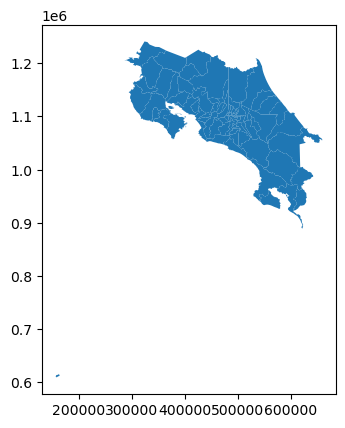

In [2]:
# Conexión al servicio WFS del IGN 5k CO
wfs_url = 'https://geos.snitcr.go.cr/be/IGN_5_CO/wfs'
wfs_version = '1.1.0'
wfs = WebFeatureService(url=wfs_url, version=wfs_version)

# Obtener la capa de cantones
capa = 'IGN_5_CO:limitecantonal_5k'
respuesta = wfs.getfeature(typename=capa, outputFormat='application/json')

# Leer la respuesta en un GeoDataFrame
cantones_gdf = gpd.read_file(BytesIO(respuesta.read()))

# Asegurarse que el CRS sea CRTM05 (EPSG 5367)
cantones_gdf = cantones_gdf.to_crs(epsg=5367)

# Reducción de columnas
cantones_gdf =cantones_gdf[['CÓDIGO_CANTÓN', 'CANTÓN', 'geometry']]

# Mapa
cantones_gdf.plot()

### Red vial

/home/mfvargas/miniconda3/envs/gf0657-2024-ii/lib/python3.12/site-packages/pyogrio/raw.py:196: RuntimeWarning: Several features with id = 0 have been found. Altering it to be unique. This warning will not be emitted anymore for this layer
  return ogr_read(


<Axes: >

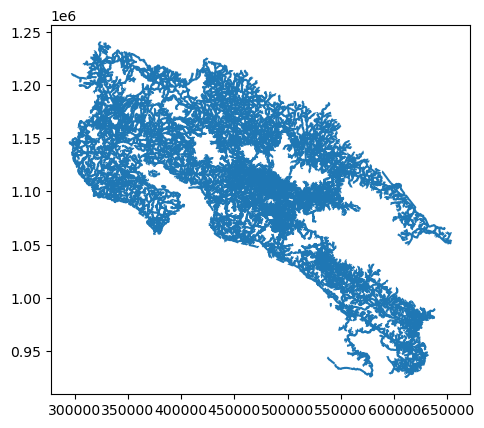

In [3]:
# Conexión al servicio WFS del IGN 200 k
wfs_url = 'https://geos.snitcr.go.cr/be/IGN_200/wfs'
wfs_version = '1.1.0'
wfs = WebFeatureService(url=wfs_url, version=wfs_version)

# Obtener la capa de red vial
capa = 'IGN_200:redvial_200k'
respuesta = wfs.getfeature(typename=capa, outputFormat='application/json')

# Leer la respuesta en un GeoDataFrame
red_vial_gdf = gpd.read_file(BytesIO(respuesta.read()))

# Asegurarse que el CRS sea CRTM05 (EPSG 5367)
red_vial_gdf = red_vial_gdf.to_crs(epsg=5367)

# Añadir una columna como identificador único
red_vial_gdf['red_vial_id'] = range(1, len(red_vial_gdf) + 1)

# Reducción de columnas
red_vial_gdf =red_vial_gdf[['red_vial_id', 'geometry']]

# Mapa
red_vial_gdf.plot()

## Análisis

In [4]:
# Generar un segmento de red vial 
# por cada intersección con un polígono de cantón
interseccion_redvial_cantones_gdf = gpd.overlay(
    red_vial_gdf, 
    cantones_gdf, 
    how='intersection'
)

interseccion_redvial_cantones_gdf.head()

,red_vial_id,CÓDIGO_CANTÓN,CANTÓN,geometry
0,1,702,Pococí,"LINESTRING (543973.13 1157346.96, 543972.52 11..."
1,2,702,Pococí,"LINESTRING (542005.8 1160843.73, 542304.68 116..."
2,3,702,Pococí,"LINESTRING (542872.85 1160705.42, 542946.13 11..."
3,4,702,Pococí,"LINESTRING (527814.53 1167099.79, 527692.44 11..."
4,5,702,Pococí,"LINESTRING (538428.65 1157738.05, 538251.35 11..."


In [5]:
# Calcular la longitud de cada segmento de red vial intersecado
interseccion_redvial_cantones_gdf["LONGITUD_RED_VIAL"] = interseccion_redvial_cantones_gdf["geometry"].length/1000

interseccion_redvial_cantones_gdf.head()

,red_vial_id,CÓDIGO_CANTÓN,CANTÓN,geometry,LONGITUD_RED_VIAL
0,1,702,Pococí,"LINESTRING (543973.13 1157346.96, 543972.52 11...",8.744950
1,2,702,Pococí,"LINESTRING (542005.8 1160843.73, 542304.68 116...",8.188802
2,3,702,Pococí,"LINESTRING (542872.85 1160705.42, 542946.13 11...",2.135535
3,4,702,Pococí,"LINESTRING (527814.53 1167099.79, 527692.44 11...",2.302054
4,5,702,Pococí,"LINESTRING (538428.65 1157738.05, 538251.35 11...",8.779122


In [6]:
# Agrupación y suma de los los segmentos de red vial por cantón
suma_redvial_cantones_df = interseccion_redvial_cantones_gdf.groupby(["CÓDIGO_CANTÓN"])["LONGITUD_RED_VIAL"].sum()

# Convertir la serie en dataframe
suma_redvial_cantones_df = suma_redvial_cantones_df.reset_index()

# Desplegar longitudes de red vial por cantón
suma_redvial_cantones_df.sort_values(by='LONGITUD_RED_VIAL', ascending=False)

,CÓDIGO_CANTÓN,LONGITUD_RED_VIAL
29,210,2591.051297
18,119,1429.560637
65,601,1319.642659
67,603,1297.086044
53,410,1103.353434
...,...,...
14,115,23.176611
50,407,20.228059
12,113,16.408723
52,409,15.105101


In [7]:
# Agregar a la capa de cantones la longitud de la red vial para cada polígono
cantones_redvial_gdf = cantones_gdf.merge(suma_redvial_cantones_df, on="CÓDIGO_CANTÓN")

# Calcular el área del cantón
cantones_redvial_gdf["ÁREA_CANTÓN"] = cantones_redvial_gdf["geometry"].area/1000000

# Calcular la densidad de la red vial
cantones_redvial_gdf["DENSIDAD_RED_VIAL"] = cantones_redvial_gdf["LONGITUD_RED_VIAL"] / cantones_redvial_gdf["ÁREA_CANTÓN"]

# Desplegar la densidad de red vial en cada cantón
cantones_redvial_gdf[['CÓDIGO_CANTÓN', 'CANTÓN', 'DENSIDAD_RED_VIAL', 'LONGITUD_RED_VIAL', 'ÁREA_CANTÓN']].sort_values(by="DENSIDAD_RED_VIAL", ascending=False)

,CÓDIGO_CANTÓN,CANTÓN,DENSIDAD_RED_VIAL,ÁREA_CANTÓN,LONGITUD_RED_VIAL
0,101,San José,2.259168,44.624281,100.813757
7,108,Goicoechea,2.148690,31.696490,68.105926
17,118,Curridabat,2.066241,16.062604,33.189212
12,113,Tibás,1.984265,8.269420,16.408723
19,120,León Cortés Castro,1.954592,121.894573,238.254156
...,...,...,...,...,...
69,605,Osa,0.351270,1932.697255,678.898890
78,701,Limón,0.291552,1769.378297,515.865160
77,613,Puerto Jiménez,0.287516,720.432119,207.135773
44,401,Heredia,0.286999,283.109113,81.252010


<Axes: >

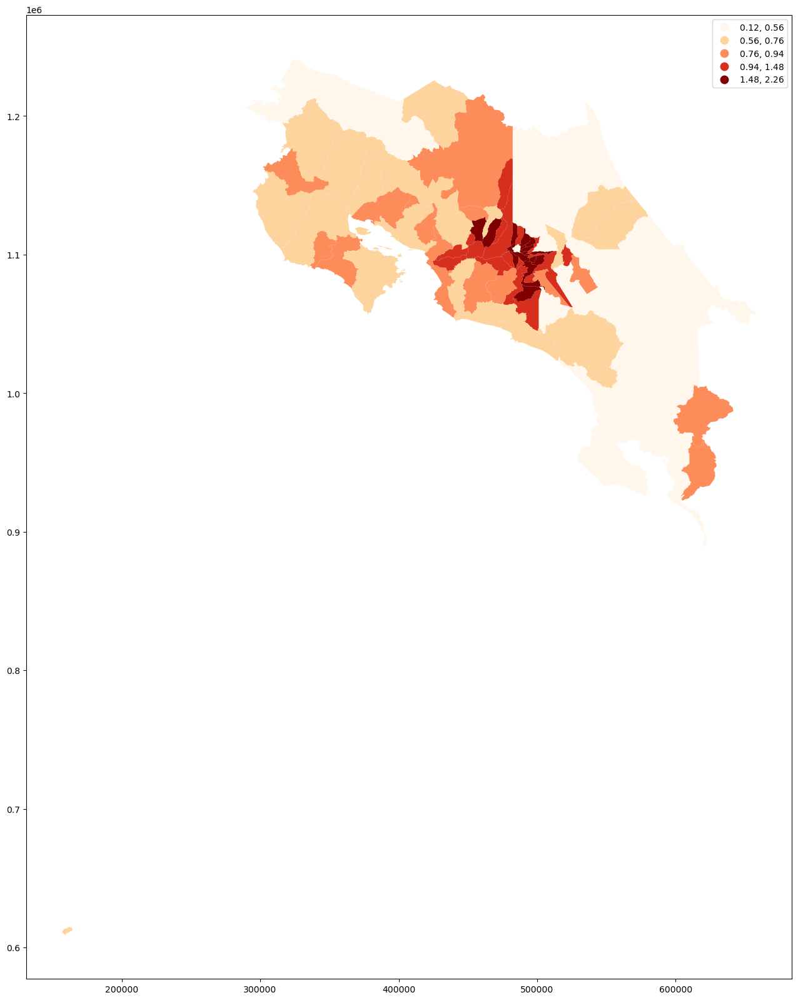

In [8]:
# Mapa estático
cantones_redvial_gdf.plot(
    column="DENSIDAD_RED_VIAL", 
    legend=True,
    cmap='OrRd', 
    scheme='quantiles',
    figsize=(20, 20)
)

In [9]:
# Antes de agregar cantones_redvial_gdf, 
# se simplifica (i.e. se reduce el número de vértices)
# para generar un HTML más pequeño (< 100 MB)

# Hacer una copia de cantones_redvial_gdf para simplificarla
cantones_redvial_simplificado_gdf = cantones_redvial_gdf

# Definir el factor de simplificación
# Cuanto mayor sea el valor, mayor será la simplificación
factor_simplificacion = 0.01

# Simplificar geometría
cantones_redvial_simplificado_gdf['geometry'] = cantones_redvial_simplificado_gdf['geometry'].simplify(
    factor_simplificacion, 
    preserve_topology=True
)

# Crear el mapa interactivo con la densidad de la red vial
m = cantones_redvial_simplificado_gdf.explore(
    column='DENSIDAD_RED_VIAL',
    name='Densidad de la red vial en cantones',
    cmap='OrRd',
    tooltip=['CANTÓN', 'DENSIDAD_RED_VIAL'],
    legend=True,
    legend_kwds={
        'caption': "Densidad de la red vial", 
        'orientation': "horizontal"
    },
)

# Agregar un control de capas al mapa
folium.LayerControl().add_to(m)

# Mostrar el mapa interactivo
m

## Ejercicios

1. Programe un mapa interactivo de coropletas que muestre la densidad de la red vial en las regiones socioeconómicas de Costa Rica.